# Analyzing SAE error in GPT2-small

...

I intend to take at least two approaches to this problem:

1. Examine per-token error terms and explore which tokens are most poorly modeled by the SAE
2. Try to correlate SAE features with downstream error



In [1]:
# boilerplate from sae-lens example
try:
    import google.colab # type: ignore
    from google.colab import output
    COLAB = True
except:
    COLAB = False
    from IPython import get_ipython # type: ignore
    ipython = get_ipython(); assert ipython is not None
    ipython.run_line_magic("load_ext", "autoreload")
    ipython.run_line_magic("autoreload", "2")

print(("not " if not COLAB else "") + "running in colab")

# if COLAB:
#     %pip install sae-lens transformer-lens sae-dashboard
# else:
#     %pip install torch torchvision torchaudio tqdm plotly pandas datasets sae-lens transformer-lens sae-dashboard

not running in colab


In [2]:
# Standard imports
import os
import torch
from tqdm import tqdm
import plotly.express as px

# Imports for displaying vis in Colab / notebook
import webbrowser
import http.server
import socketserver
import threading
PORT = 8000

torch.set_grad_enabled(False); # might want to enable this to use attribution

In [3]:
if torch.backends.mps.is_available():
    device = "mps"
else:
    device = "cuda" if torch.cuda.is_available() else "cpu"

print(f"Device: {device}")

Device: mps


In [4]:
def display_vis_inline(filename: str, height: int = 850):
    '''
    Displays the HTML files in Colab. Uses global `PORT` variable defined in prev cell, so that each
    vis has a unique port without having to define a port within the function.
    '''
    if not(COLAB):
        webbrowser.open(filename);

    else:
        global PORT

        def serve(directory):
            os.chdir(directory)

            # Create a handler for serving files
            handler = http.server.SimpleHTTPRequestHandler

            # Create a socket server with the handler
            with socketserver.TCPServer(("", PORT), handler) as httpd:
                print(f"Serving files from {directory} on port {PORT}")
                httpd.serve_forever()

        thread = threading.Thread(target=serve, args=("/content",))
        thread.start()

        output.serve_kernel_port_as_iframe(PORT, path=f"/{filename}", height=height, cache_in_notebook=True)

        PORT += 1

## Per-token error terms
Here's what I'm thinking for my approach to this:
- I'll use the original GPT2-small and a version with one of the medium/late layer residual streams replaced with a pretrained SAE reconstruction
- Compute KL divergence* for every token in a reasonably sized dataset
- Visualize some examples to see if there are any obvious patterns
- Plot a histogram of which tokens have the highest (and lowest) KL divergence
- Hopefully have the results from above inform additional exploration

\* I think it makes sense to use KL divergence instead of loss since it's a little bit richer, but I'm not super confident about this

In [5]:
from datasets import load_dataset
from transformer_lens import HookedTransformer
from sae_lens import SAE

model = HookedTransformer.from_pretrained("gpt2-small", device = device)
# model = HookedTransformer.from_pretrained("pythia-70m-deduped", device = device)

# using Joseph Bloom's pretrained SAEs
test_sae, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.8.hook_resid_pre", # won't always be a hook point
    device = device
)

# test_sae, _, _ = SAE.from_pretrained(
#     release = "pythia-70m-deduped-res-sm", # see other options in sae_lens/pretrained_saes.yaml
#     sae_id = "blocks.3.hook_resid_post", # won't always be a hook point
#     device = device
# )

# test_sae, _, _ = SAE.from_pretrained(
#     release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
#     sae_id = "blocks.8.hook_resid_pre", # won't always be a hook point
#     device = device
# )


/Users/jake/.pyenv/versions/3.11.2/envs/sae_error/lib/python3.11/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Loaded pretrained model gpt2-small into HookedTransformer


This SAE patches the residual stream between layers 7 and 8.

According to SAELens docs, this SAE explains ~90% of variance, so I'll be trying to understand some of the other 10%.

In [6]:
from transformer_lens.utils import tokenize_and_concatenate
from transformers import AutoTokenizer
from torch.utils.data import DataLoader, IterableDataset


# my_dataset = load_dataset(
#     path = "EleutherAI/the_pile_deduplicated",
#     split="train",
#     streaming=True,
# )

# my_dataset = load_dataset(
#     path = "monology/pile-uncopyrighted",
#     split="train",
#     streaming=True,
# )

my_dataset = load_dataset(
    path="Skylion007/openwebtext",
    split="train",
    streaming=True,
    trust_remote_code=True,
)

# my_tokenizer = AutoTokenizer.from_pretrained("gpt2")
my_tokenizer = model.tokenizer

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [7]:
class StreamingTokenDataset(IterableDataset):
    def __init__(self, dataset, tokenizer, ctx_len=1024, batch_size=32, single_row_per_example=False, prepend_bos=False):
        self.dataset = dataset
        self.tokenizer = tokenizer
        self.ctx_len = ctx_len
        self.batch_size = batch_size
        self.single_row_per_example = single_row_per_example
        self.prepend_bos = prepend_bos

    def __iter__(self):
        buffer = []
        buffer_len = 0

        for example in self.dataset:
            text = self.tokenizer.bos_token + example["text"] if self.prepend_bos else example["text"]
            tokens = self.tokenizer(text, max_length=self.ctx_len-buffer_len, truncation=True).input_ids
            buffer.extend(tokens)
            buffer_len += len(tokens)
            if buffer_len >= self.ctx_len:
                yield torch.tensor(buffer)
                buffer = []
                buffer_len = 0
            elif self.single_row_per_example:
                buffer = []
                buffer_len = 0

def collate_fn(batch):
    return torch.stack(batch)

In [8]:
test_sae.cfg

SAEConfig(architecture='standard', d_in=768, d_sae=24576, activation_fn_str='relu', apply_b_dec_to_input=True, finetuning_scaling_factor=False, context_size=128, model_name='gpt2-small', hook_name='blocks.8.hook_resid_pre', hook_layer=8, hook_head_index=None, prepend_bos=True, dataset_path='Skylion007/openwebtext', dataset_trust_remote_code=True, normalize_activations='none', dtype='torch.float32', device='mps', sae_lens_training_version=None, activation_fn_kwargs={})

In [9]:
tokenized_dataset = StreamingTokenDataset(my_dataset, my_tokenizer, ctx_len=128, single_row_per_example=True, prepend_bos=True)
data_loader = DataLoader(tokenized_dataset, batch_size=16, collate_fn=collate_fn)

Oops, I didn't realize that these SAEs were trained on shorter contexts. Let's use the correct context length and try again.

In [13]:
token_batch = next(iter(data_loader))
token_batch = token_batch.to(device)
l0 = test_l0(token_batch, test_sae)

print("average l0", l0.mean().item())
px.histogram(l0.flatten().cpu().numpy()).show()

average l0 66.38238525390625


In [10]:
from transformer_lens import utils
from functools import partial
import torch.nn.functional as F


def kl_divergence(p, log_q, dim=1):
    kl_div = F.kl_div(log_q, p, reduction='none')
    return kl_div.mean(dim=dim)

def recon_hook(activation, hook, sae_out):
    return sae_out

def get_metrics_for_batch(batch, sae):
    orig_logits = model(batch, return_type="logits")
    orig_probs = F.softmax(orig_logits, dim=2)
    _, cache = model.run_with_cache(batch)

    feature_acts = sae.encode(cache[sae.cfg.hook_name])
    sae_out = sae.decode(feature_acts)

    rec_logits = model.run_with_hooks(
        batch,
        fwd_hooks=[
            (
                sae.cfg.hook_name,
                partial(recon_hook, sae_out=sae_out),
            )
        ],
        return_type="logits",
    )
    rec_log_probs = F.log_softmax(rec_logits, dim=2)
    kl_divs = kl_divergence(orig_probs, rec_log_probs, dim=2)
    losses = model.loss_fn(orig_logits, batch, per_token=True)
    return kl_divs, losses

def normalize(x):
    return (x - x.min()) / (x.max() - x.min())

FILENO = 0

def display_error_vis(strings, error_terms):
    assert len(strings) == len(error_terms)
    global FILENO
    html_string = "<html><body style='background-color:#FFF;'><p style='color:black;'>"
    norm_error = normalize(error_terms)

    for string, error in zip(strings, norm_error):
        r = 255 - error * 255
        color = f"rgb(255, {r:.0f}, {r:.0f})"  # Red intensity
        html_string += f"<span style='background-color:{color};'>{string}</span>"

    html_string += "</p></body></html>"

    # Save the HTML string to a file
    filename = f"b_highlighted_strings_{FILENO}.html"
    FILENO += 1
    with open(filename, "w") as file:
        file.write(html_string)
    print(f"Saving file: {filename}")
    display_vis_inline(filename)

In [11]:
test_tokens = next(iter(data_loader))

test_strings = [model.tokenizer.decode(t) for t in test_tokens.flatten()]
print(test_strings)

['<|endoftext|>', 'Port', '-', 'au', '-', 'Prince', ',', ' Haiti', ' (', 'CNN', ')', ' --', ' Earthquake', ' victims', ',', ' wr', 'ithing', ' in', ' pain', ' and', ' grasping', ' at', ' life', ',', ' watched', ' doctors', ' and', ' nurses', ' walk', ' away', ' from', ' a', ' field', ' hospital', ' Friday', ' night', ' after', ' a', ' Belgian', ' medical', ' team', ' evacuated', ' the', ' area', ',', ' saying', ' it', ' was', ' concerned', ' about', ' security', '.', '\n', '\n', 'The', ' decision', ' left', ' CNN', ' Chief', ' Medical', ' Correspond', 'ent', ' San', 'jay', ' Gupta', ' as', ' the', ' only', ' doctor', ' at', ' the', ' hospital', ' to', ' get', ' the', ' patients', ' through', ' the', ' night', '.', '\n', '\n', 'CNN', ' initially', ' reported', ',', ' based', ' on', ' conversations', ' with', ' some', ' of', ' the', ' doctors', ',', ' that', ' the', ' United', ' Nations', ' ordered', ' the', ' Belgian', ' First', ' Aid', ' and', ' Support', ' Team', ' to', ' evacuate', '

In [16]:
# something interesting here is that KL divergence seems to be highly localized; KL is high for a single token and low for surrounding tokens.

In [17]:
test_tokens = next(iter(data_loader))

test_strings = [model.tokenizer.decode(t) for t in test_tokens.flatten()]
test_strings = [s if s != "<|endoftext|>" else "<br/><br/>"for s in test_strings]

test_kl_divs, test_losses = get_metrics_for_batch(test_tokens, test_sae)

display_error_vis(test_strings, test_kl_divs.flatten())

Saving file: b_highlighted_strings_0.html


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [12]:
# add a zero to the right side of the loss vector for each token sequence
def pad_losses(losses):
    return F.pad(losses, (0, 1), "constant", 0)

In [19]:

test_padded_losses = pad_losses(test_losses)
display_error_vis(test_strings, test_padded_losses.flatten())

Saving file: b_highlighted_strings_1.html


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [13]:
LOSS_THRESHOLD = 7

# mask metric based on loss (we want to ignore tokens where the loss on the original model is very high)
def mask_high_loss_tokens(metric, padded_losses):
    bad_prediction_mask = (padded_losses > LOSS_THRESHOLD) * 1.0
    masked_metric = metric * (1 - bad_prediction_mask)
    return masked_metric

# test_masked_kl_divs = mask_high_loss_tokens(test_kl_divs, test_padded_losses)
# display_error_vis(test_strings, test_masked_kl_divs.flatten())

In [14]:
from collections import defaultdict

def process_batch_statistics(batch, kl_dict, loss_dict, sae):
    kl_divs, losses = get_metrics_for_batch(batch, sae)
    padded_losses = pad_losses(losses)
    for row_idx in range(batch.shape[0]):
        for token_idx, kl_divergence, loss in zip(batch[row_idx], kl_divs[row_idx], padded_losses[row_idx]):
            token_idx = token_idx.cpu().item()
            kl_dict[token_idx].append(kl_divergence.cpu().item())
            loss_dict[token_idx].append(loss.cpu().item())

In [22]:
n_batches = 5000

data_iter = iter(data_loader)
my_kl_dict = defaultdict(list)
my_loss_dict = defaultdict(list)

for _ in tqdm(range(n_batches)):
    token_batch = next(data_iter).to(device)
    process_batch_statistics(token_batch, my_kl_dict, my_loss_dict, test_sae)

100%|█████████████████████████████████████| 5000/5000 [2:10:49<00:00,  1.57s/it]


In [15]:
import numpy as np

KL_VIS_THRESHOLDS = np.linspace(2e-6, 2e-5, 10)

def process_stats_dict(kl_dict, loss_dict, filter_loss_threshold=LOSS_THRESHOLD):
    output_dict = defaultdict(dict)
    for token_idx, div_list in tqdm(kl_dict.items()):
        # # skip <|endoftext|>
        # if token_idx == 50256:
        #     continue
        # if len(div_list) < 500:
        #     continue
        loss_list = loss_dict[token_idx]
        assert(len(loss_list) == len(div_list))
        # div_list = np.random.choice(div_list, 1000, replace=False)
        div_array = np.array(div_list)
        loss_array = np.array(loss_list)
        # filter the div array based on loss
        div_array = div_array[loss_array <= filter_loss_threshold]
        # if len(div_array) < 500:
        if not len(div_array):
            continue
        token_stats = output_dict[token_idx]
        token_stats["string"] = repr(my_tokenizer.decode(token_idx))
        token_stats["mean"] = div_array.mean()
        token_stats["max"] = div_array.max()
        token_stats["min"] = div_array.min()
        token_stats["median"] = np.median(div_array)
        token_stats["geo_mean"] = np.exp(np.log(div_array).mean())
        token_stats["count"] = len(div_array)
        for thresh in KL_VIS_THRESHOLDS:
            token_stats[f"n_over_{thresh}"] = (div_array >= thresh).sum()
            token_stats[f"ratio_over_{thresh}"] = token_stats[f"n_over_{thresh}"] / token_stats["count"]
    return output_dict

In [24]:
my_output_dict = process_stats_dict(my_kl_dict, my_loss_dict, filter_loss_threshold=7)

100%|██████████████████████████████████| 49040/49040 [00:03<00:00, 12679.11it/s]


In [16]:
import pandas as pd
import uuid

def plot_metric_curve(df, metrics, sort_idx=0):
    # sorted_outputs = sorted(output_dict.items(), key=lambda item: item[1]["ratio_over_thresh"], reverse=False)
    sorted_df = df.sort_values(metrics[sort_idx])
    sorted_df["order"] = range(len(sorted_df))
    px.line(sorted_df, x="order", y=metrics, hover_data="string").show()

In [29]:
my_output_df = pd.DataFrame(my_output_dict).T
# output_filename = f"gpt_stats_df_block_8.csv"
# print(f"Writing output to {output_filename}")
# my_output_df.to_csv()

ratios = [f"ratio_over_{t}" for t in KL_VIS_THRESHOLDS]
my_filtered_df = my_output_df[my_output_df['count'] >= 200]
plot_metric_curve(my_filtered_df, ratios, sort_idx=-1)
plot_metric_curve(my_filtered_df, ["median", "mean", "geo_mean"])

In [33]:
my_sorted_df = my_filtered_df.sort_values("median", ascending=False)
# my_sorted_df = my_sorted_df[my_sorted_df["count"] >= 200].drop(["min", "max"], axis=1)
# print(my_sorted_df.sample(frac=1).tail(40))
top_n_percent_sample = my_sorted_df.head(len(my_sorted_df)//20).sample(frac=1)
# my_sorted_df.head(20)[["string", "median", "count"]]
top_n_percent_sample.head(20)[["string", "median", "count"]]

,string,median,count
1565,'AN',0.000007,542
3955,'IM',0.000006,252
306,'ly',0.000004,2330
328,'ig',0.000006,836
377,'ul',0.000006,577
85,'v',0.000004,1203
463,'ud',0.000005,385
3601,' print',0.000004,235
417,'el',0.000004,1447
603,'ail',0.000004,221


In [28]:
assert False

AssertionError: 

In [ ]:
my_output_df = pd.read_csv("blocks.3.hook_resid_post_stats_df.csv", index_col=0)
my_sorted_df = my_output_df.sort_values("ratio_over_8e-06", ascending=False)
my_sorted_df = my_sorted_df[my_sorted_df["count"] >= 200].drop(["min", "max"], axis=1)
# print(my_sorted_df.sample(frac=1).tail(40))
# top_n_percent = my_sorted_df.head(len(my_sorted_df)//20)# .sample(frac=1)
my_sorted_df.head(20)[["string", "ratio_over_8e-06", "count"]]

,string,ratio_over_8e-06,count
0,'<|endoftext|>',1.000000,2756
30952,'<!',0.996815,314
41497,'\ufeff',0.986667,300
6189,'Trans',0.978571,280
50,'Q',0.973681,15616
1697,'р',0.960352,227
693,'erm',0.958506,241
34721,'Effects',0.947368,209
499,' pl',0.938596,342
4554,' cyt',0.938272,243


In [ ]:
import pandas as pd
from scipy import stats

# Assuming your dataframe is called 'df'
r, p = stats.pearsonr(my_sorted_df['count'], my_sorted_df['median'])

print(f"Correlation coefficient (r): {r}")
print(f"P-value (p): {p}")

Correlation coefficient (r): -0.03984206481713329
P-value (p): 0.004145659629490699


In [34]:
fig = px.scatter(my_sorted_df, x='count', y='median', 
                 hover_data="string",
                 log_x=True,
                 title='Relationship between Count and Median',
                 labels={'count': 'Count', 'median': 'Median'},
                 trendline_color_override="red",
                 trendline='ols', trendline_options=dict(log_x=True))  # Adds a linear trendline

fig.show()

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [35]:
from scipy import stats

# Assuming your dataframe is called 'df'
rho, p_value = stats.spearmanr(my_sorted_df['count'], my_sorted_df['median'])

# Calculate variance explained (this is an approximation for Spearman)
variance_explained = rho**2 * 100

print(f"Spearman correlation coefficient (rho): {rho:.4f}")
print(f"P-value: {p_value:.4f}")
print(f"Approximate variance explained: {variance_explained:.2f}%")

Spearman correlation coefficient (rho): -0.1563
P-value: 0.0000
Approximate variance explained: 2.44%


In [ ]:
n_batches = 1000
filter_loss_threshold = 7
examples = {}
mean_kl_per_example = {}
geo_mean_kl_per_example = {}
median_kl_per_example = {}

data_iter = iter(data_loader)

for batch_idx in tqdm(range(n_batches)):
    token_batch = next(data_iter)
    batch_size = token_batch.shape[0]
    kl_divs, loss = get_metrics_for_batch(token_batch, test_sae)
    loss = pad_losses(loss)
    kl_divs = kl_divs.cpu().numpy()
    loss = loss.cpu().numpy()
    for example_idx in range(batch_size):
        filtered_kl_divs = kl_divs[example_idx][loss[example_idx] <= filter_loss_threshold]
        if len(filtered_kl_divs):
            mean_kl = filtered_kl_divs.mean()
            geo_mean_kl = np.exp(np.log(filtered_kl_divs).mean())
            median_kl = np.median(filtered_kl_divs)
        else:
            mean_kl, geo_mean_kl, median_kl = 0, 0, 0
        example_id = batch_size * batch_idx + example_idx
        examples[example_id] = token_batch[example_idx]
        mean_kl_per_example[example_id] = mean_kl
        geo_mean_kl_per_example[example_id] = geo_mean_kl
        median_kl_per_example[example_id] = median_kl



  1%|▎                                         | 7/1000 [00:04<08:36,  1.92it/s]/var/folders/jh/qyj53ggn7lj4rpckc3m2dwd80000gn/T/ipykernel_78747/1133151200.py:19: RuntimeWarning:

invalid value encountered in log

100%|███████████████████████████████████████| 1000/1000 [07:49<00:00,  2.13it/s]


In [ ]:
example_df = pd.DataFrame({
    'mean_kl': mean_kl_per_example,
    'geo_mean_kl': geo_mean_kl_per_example,
    'median_kl': median_kl_per_example,
    'tokens': examples,
})

for idx, row in example_df.sort_values('median_kl', ascending=False).head(20).iterrows():
    row_strings = [model.tokenizer.decode(t) for t in row['tokens']]
    row_tensor = torch.unsqueeze(row['tokens'], 0)
    row_kl, row_loss = get_metrics_for_batch(row_tensor, test_sae)
    display_error_vis(row_strings, row_kl.flatten())
    print(my_tokenizer.decode(row['tokens']))
    print("\n\n\n%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%\n\n\n")

In [ ]:
assert False

AssertionError: 

In [63]:
ratios = [f"ratio_over_{t}" for t in KL_VIS_THRESHOLDS]

n_batches = 5000

for block_num in "1 4 9 10 11".split():
    sae_id = f"blocks.{block_num}.hook_resid_pre"
    print(f"Processing {sae_id}...")
    layer_sae, _, _ = SAE.from_pretrained(
        release = "gpt2-small-res-jb",
        sae_id = sae_id,
        device = device
    )
    data_iter = iter(data_loader)
    layer_kl_dict = defaultdict(list)
    layer_loss_dict = defaultdict(list)

    for _ in tqdm(range(n_batches)):
        token_batch = next(data_iter).to(device)
        process_batch_statistics(token_batch, layer_kl_dict, layer_loss_dict, layer_sae)
    layer_output_dict = process_stats_dict(layer_kl_dict, layer_loss_dict, filter_loss_threshold=7)
    layer_output_df = pd.DataFrame(layer_output_dict).T
    output_filename = f"gpt2_{sae_id}_stats_df.csv"
    print(f"Writing output DF to {output_filename}")
    layer_output_df.to_csv(output_filename)
    viz_df = layer_output_df[layer_output_df['count'] >= 200]
    # plot_metric_curve(viz_df, ratios, sort_idx=-1)
    plot_metric_curve(viz_df, ["median", "mean", "geo_mean"])

Processing blocks.1.hook_resid_pre...


  0%|                                       | 1/49040 [00:00<3:06:18,  4.39it/s]/var/folders/jh/qyj53ggn7lj4rpckc3m2dwd80000gn/T/ipykernel_8738/3721941946.py:29: RuntimeWarning:

invalid value encountered in log

100%|██████████████████████████████████| 49040/49040 [00:03<00:00, 12730.58it/s]


Writing output DF to gpt2_blocks.1.hook_resid_pre_stats_df.csv


Processing blocks.4.hook_resid_pre...


  0%|                                        | 46/49040 [00:00<08:40, 94.18it/s]/var/folders/jh/qyj53ggn7lj4rpckc3m2dwd80000gn/T/ipykernel_8738/3721941946.py:29: RuntimeWarning:

invalid value encountered in log

100%|██████████████████████████████████| 49040/49040 [00:03<00:00, 12297.57it/s]


Writing output DF to gpt2_blocks.4.hook_resid_pre_stats_df.csv


Processing blocks.9.hook_resid_pre...


100%|██████████████████████████████████| 49040/49040 [00:03<00:00, 12910.22it/s]


Writing output DF to gpt2_blocks.9.hook_resid_pre_stats_df.csv


Processing blocks.10.hook_resid_pre...


  0%|                                        | 46/49040 [00:00<09:08, 89.34it/s]/var/folders/jh/qyj53ggn7lj4rpckc3m2dwd80000gn/T/ipykernel_8738/3721941946.py:29: RuntimeWarning:

invalid value encountered in log

100%|██████████████████████████████████| 49040/49040 [00:04<00:00, 12011.95it/s]


Writing output DF to gpt2_blocks.10.hook_resid_pre_stats_df.csv


Processing blocks.11.hook_resid_pre...


  5%|█▊                                  | 2539/49040 [00:01<00:09, 4815.77it/s]/var/folders/jh/qyj53ggn7lj4rpckc3m2dwd80000gn/T/ipykernel_8738/3721941946.py:29: RuntimeWarning:

invalid value encountered in log

100%|██████████████████████████████████| 49040/49040 [00:03<00:00, 12505.38it/s]


Writing output DF to gpt2_blocks.11.hook_resid_pre_stats_df.csv


In [ ]:
layer_output_df = pd.read_csv("blocks.3.hook_resid_post_stats_df.csv", index_col=0)
# TODO: should've used repr for saving strings, newlines break the csv
layer_output_df = layer_output_df[layer_output_df.notnull().all(1)]
layer_output_df = layer_output_df[layer_output_df["count"] >= 200]
plot_metric_curve(layer_output_df, ratios, sort_idx=-1)

In [36]:
layer_output_df = my_filtered_df

In [37]:
def get_highest_consecutive_ratio_diff(row):
    max_diff = 0
    for i in range(len(ratios) - 1):
        lo = ratios[i]
        hi = ratios[i+1]
        diff = row[lo] - row[hi]
        max_diff = max(diff, max_diff)
    return max_diff

layer_output_df["max_diff"] = layer_output_df.apply(get_highest_consecutive_ratio_diff, axis=1)
layer_output_df.head()

/var/folders/jh/qyj53ggn7lj4rpckc3m2dwd80000gn/T/ipykernel_8738/2495536589.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,string,mean,max,min,median,geo_mean,count,n_over_2e-06,ratio_over_2e-06,n_over_4e-06,...,ratio_over_1.1999999999999999e-05,n_over_1.4e-05,ratio_over_1.4e-05,n_over_1.6e-05,ratio_over_1.6e-05,n_over_1.8e-05,ratio_over_1.8e-05,n_over_2e-05,ratio_over_2e-05,max_diff
50256,'<|endoftext|>',0.0,0.0,0.0,0.0,0.0,39009,0,0.0,0,...,0.0,0,0.0,0,0.0,0,0.0,0,0.0,0.000000
12,'-',0.000005,0.000149,0.0,0.000002,0.000001,88068,47329,0.537414,30724,...,0.087183,5901,0.067005,4617,0.052425,3725,0.042297,3039,0.034507,0.188547
559,'au',0.000007,0.000073,0.0,0.000003,0.000002,547,338,0.617916,232,...,0.177331,78,0.142596,60,0.109689,49,0.08958,38,0.06947,0.193784
11,"','",0.000003,0.000275,0.0,0.000002,0.000002,300283,135502,0.451248,45460,...,0.016881,3620,0.012055,2752,0.009165,2161,0.007197,1712,0.005701,0.299857
357,' (',0.000005,0.000215,0.0,0.000002,0.000002,25734,14807,0.575387,7822,...,0.077679,1613,0.06268,1319,0.051255,1090,0.042356,929,0.0361,0.271431


In [38]:
plot_metric_curve(layer_output_df, ["max_diff"])

In [49]:
layer_output_df[layer_output_df["string"] == "' Tuesday'"]

,string,mean,max,min,median,geo_mean,count,n_over_2e-06,ratio_over_2e-06,n_over_4e-06,...,ratio_over_1.1999999999999999e-05,n_over_1.4e-05,ratio_over_1.4e-05,n_over_1.6e-05,ratio_over_1.6e-05,n_over_1.8e-05,ratio_over_1.8e-05,n_over_2e-05,ratio_over_2e-05,max_diff
3431,' Tuesday',0.000002,0.000084,0.0,0.000001,0.000001,3416,1169,0.342213,402,...,0.00966,23,0.006733,15,0.004391,14,0.004098,12,0.003513,0.224532


In [39]:
string_values = layer_output_df.sort_values("max_diff", ascending=False).head(20)[["string", "max_diff"]]
px.bar(string_values, x="string", y="max_diff").show()

In [66]:
for block_num in "012345":
    sae_id = f"blocks.{block_num}.hook_resid_post"
    filename = f"{sae_id}_stats_df.csv"
    print(sae_id)
    layer_output_df = pd.read_csv(filename, index_col=0)
    layer_output_df = layer_output_df[layer_output_df.notnull().all(1)]
    layer_output_df = layer_output_df[layer_output_df["count"] >= 200]
    layer_output_df["max_diff"] = layer_output_df.apply(get_highest_consecutive_ratio_diff, axis=1)
    string_values = layer_output_df.sort_values("max_diff", ascending=False).head(20)[["string", "max_diff"]]
    px.bar(string_values, x="string", y="max_diff").show()
    # plot_metric_curve(layer_output_df, ["max_diff"])
    

blocks.0.hook_resid_post


blocks.1.hook_resid_post


blocks.2.hook_resid_post


blocks.3.hook_resid_post


blocks.4.hook_resid_post


blocks.5.hook_resid_post


In [74]:
correlation_df["r_squared"] = correlation_df["r"].apply(lambda row: row**2)
correlation_df["r_squared"].cumsum()

0        0.000085
1        0.000142
2        0.000185
3        0.000248
4        0.000255
           ...   
24571    3.591526
24572    3.591538
24573    3.593493
24574    3.593523
24575    3.593639
Name: r_squared, Length: 24576, dtype: float64

In [ ]:
dfs = []

for block_num in "012345":
    sae_id = f"blocks.{block_num}.hook_resid_post"
    filename = f"{sae_id}_stats_df.csv"
    print(sae_id)
    layer_output_df = pd.read_csv(filename, index_col=0)
    layer_output_df = layer_output_df[layer_output_df.notnull().all(1)]
    layer_output_df = layer_output_df[layer_output_df["count"] >= 200]
    layer_output_df["max_diff"] = layer_output_df.apply(get_highest_consecutive_ratio_diff, axis=1)
    layer_output_df = layer_output_df[["string", "max_diff"]]
    # layer_output_df = layer_output_df.sort_values("max_diff", ascending=False).head(20)
    layer_output_df["block"] = f"Block {block_num}"
    dfs.append(layer_output_df)

# Combine all dataframes
combined_df = pd.concat(dfs)

# Calculate average max_diff for each string across all blocks
avg_max_diff = combined_df.groupby("string")["max_diff"].median().sort_values(ascending=False)

# Get top 20 strings based on average max_diff
top_20_strings = avg_max_diff.head(40).index.tolist()

# Filter combined_df to include only top 20 strings
filtered_df = combined_df[combined_df["string"].isin(top_20_strings)]

color_map = {
    "Block 0": "#FF6B6B",
    "Block 1": "#FFA06B",
    "Block 2": "#FECA57",
    "Block 3": "#48DBAC",
    "Block 4": "#54A0FF",
    "Block 5": "#5F27CD"
}

# Create the plot
fig = px.bar(filtered_df, x="string", y="max_diff", color="block", barmode="group",
             title="Top 20 Strings by Average Max Diff Across Blocks",
             labels={"string": "String", "max_diff": "Max Diff", "block": "Block"},
             category_orders={"string": top_20_strings, "block": [f"Block {i}" for i in range(6)]},
             color_discrete_map=color_map)

# Adjust layout for better readability
fig.update_layout(
    xaxis_tickangle=-45,
    legend_title_text="Block",
    height=600,
    width=1000
)

fig.show()

blocks.0.hook_resid_post
blocks.1.hook_resid_post
blocks.2.hook_resid_post
blocks.3.hook_resid_post
blocks.4.hook_resid_post
blocks.5.hook_resid_post


In [40]:
data_iter = iter(data_loader)
# token_counts = defaultdict(int)
token_pos_acc = defaultdict(list)

n_batch = 5000
for batch_idx in tqdm(range(n_batch)):
    token_batch = next(data_iter).cpu().numpy()
    for sample in token_batch:
        for pos_idx, token in enumerate(sample):
            token_str = repr(my_tokenizer.decode(token))
            # token_counts[token_str] += 1
            token_pos_acc[token_str].append(pos_idx)

100%|███████████████████████████████████████| 5000/5000 [02:32<00:00, 32.80it/s]


In [50]:
px.histogram(token_pos_acc["' Monday'"], nbins=128)

In [45]:
selected_tokens = ["'Monday'", "'Tuesday'", "'Wednesday'", "'Thursday'", "'Friday'"]

# Create a list of dataframes, one for each selected token
dfs = []
for token in selected_tokens:
    if token in token_pos_acc:
        positions = token_pos_acc[token]
        df = pd.DataFrame({'position': positions, 'token': token})
        dfs.append(df)

# Concatenate all dataframes
df_combined = pd.concat(dfs, ignore_index=True)

# Create the histogram
fig = px.histogram(df_combined, x='position', color='token', barmode='group',
                   nbins=128, title='Histogram of Selected Token Positions')

# Update layout for better readability
fig.update_layout(
    xaxis_title='Position',
    yaxis_title='Count',
    legend_title='Tokens',
    bargap=0.2,  # gap between bars of adjacent location coordinates
    bargroupgap=0.1  # gap between bars of the same location coordinates
)

# Show the plot
fig.show()

In [ ]:
token_stats_df = pd.DataFrame({
    "counts": token_counts,
    "pos_acc": token_pos_acc
})
token_stats_df["avg_pos"] = token_stats_df.apply(
    lambda row: row["pos_acc"] / row["counts"],
    axis=1
)

token_stats_df.head()

,counts,pos_acc,avg_pos
'<|endoftext|>',80000,0,0.000000
'It',2912,174623,59.966690
' is',81322,5126429,63.038649
' done',1021,73897,72.377081
"','",288542,20122902,69.739941


In [ ]:
my_tokenizer.decode(next(iter(data_loader))[0])

'Port-au-Prince, Haiti (CNN) -- Earthquake victims, writhing in pain and grasping at life, watched doctors and nurses walk away from a field hospital Friday night after a Belgian medical team evacuated the area, saying it was concerned about security.\n\nThe decision left CNN Chief Medical Correspondent Sanjay Gupta as the only doctor at the hospital to get the patients through the night.\n\nCNN initially reported, based on conversations with some of the doctors, that the United Nations ordered the Belgian First Aid and Support Team to evacuate. However, Belgian Chief Coordinator Geert Gijs, a doctor who was at the hospital with'

In [ ]:
from collections import defaultdict
import numpy as np
import pandas as pd

n_batches = 200
filter_loss_threshold = 100
pos_kls = defaultdict(list)
data_iter = iter(data_loader)

for batch_idx in tqdm(range(n_batches)):
    token_batch = next(data_iter)
    # token_batch[:, 1:] = token_batch[:, :-1]
    # token_batch[:, 0] = 50256
    batch_size = token_batch.shape[0]
    kl_divs, loss = get_metrics_for_batch(token_batch, test_sae)
    loss = pad_losses(loss)
    kl_divs = kl_divs.cpu().numpy()
    loss = loss.cpu().numpy()
    pos = np.tile(np.arange(128), (16, 1))
    for example_idx in range(batch_size):
        filter_mask = loss[example_idx] <= filter_loss_threshold
        filtered_kl_divs = kl_divs[example_idx][filter_mask]
        filtered_pos = pos[example_idx][filter_mask]
        if len(filtered_kl_divs):
            for pos_idx, kl in zip(filtered_pos, filtered_kl_divs):
                pos_kls[pos_idx].append(kl)

  0%|                                                   | 0/200 [00:00<?, ?it/s]

 51%|████████████████████▉                    | 102/200 [05:13<05:01,  3.07s/it]


KeyboardInterrupt: 

In [ ]:
my_tokenizer.encode("<|endoftext|>")

[50256]

In [ ]:
pos_kl_avgs = {}
for pos_idx, kl_list in pos_kls.items():
    pos_kl_avg = np.median(kl_list)
    pos_kl_avgs[pos_idx] = pos_kl_avg

df = pd.DataFrame(list(pos_kl_avgs.items()), columns=['pos_idx', 'avg_kl'])

px.bar(df, x='pos_idx', y='avg_kl').show()

In [ ]:
n_batches = 5000

def process_batch_statistics_with_position(batch, kl_dict, loss_dict, pos_dict, sae):
    kl_divs, losses = get_metrics_for_batch(batch, sae)
    padded_losses = pad_losses(losses)
    for row_idx in range(batch.shape[0]):
        for pos_idx, (token_idx, kl_divergence, loss) in enumerate(zip(batch[row_idx], kl_divs[row_idx], padded_losses[row_idx])):
            token_idx = token_idx.cpu().item()
            kl_dict[token_idx].append(kl_divergence.cpu().item())
            loss_dict[token_idx].append(loss.cpu().item())
            pos_dict[token_idx].append(pos_idx)

data_iter = iter(data_loader)
my_kl_dict = defaultdict(list)
my_loss_dict = defaultdict(list)
my_pos_dict = defaultdict(list)

for _ in tqdm(range(n_batches)):
    token_batch = next(data_iter).to(device)
    process_batch_statistics_with_position(token_batch, my_kl_dict, my_loss_dict, my_pos_dict, test_sae)


100%|█████████████████████████████████████| 5000/5000 [1:29:29<00:00,  1.07s/it]


In [ ]:
def process_stats_dict_with_position(kl_dict, loss_dict, pos_dict, filter_loss_threshold=LOSS_THRESHOLD, filter_pos_idx=-1):
    output_dict = defaultdict(dict)
    for token_idx, div_list in tqdm(kl_dict.items()):
        loss_list = loss_dict[token_idx]
        pos_list = pos_dict[token_idx]
        assert(len(loss_list) == len(div_list))
        assert(len(loss_list) == len(pos_list))
        # div_list = np.random.choice(div_list, 1000, replace=False)
        div_array = np.array(div_list)
        loss_array = np.array(loss_list)
        pos_array = np.array(pos_list)
        # filter the div array based on loss
        loss_mask = loss_array <= filter_loss_threshold
        pos_mask = pos_array >= filter_pos_idx
        filter_mask = loss_mask & pos_mask
        div_array = div_array[filter_mask]
        pos_array = pos_array[filter_mask]
        # if len(div_array) < 500:
        if not len(div_array):
            continue
        token_stats = output_dict[token_idx]
        token_stats["string"] = repr(my_tokenizer.decode(token_idx))
        token_stats["mean"] = div_array.mean()
        token_stats["max"] = div_array.max()
        token_stats["min"] = div_array.min()
        token_stats["median"] = np.median(div_array)
        token_stats["geo_mean"] = np.exp(np.log(div_array).mean())
        token_stats["count"] = len(div_array)
        for thresh in KL_VIS_THRESHOLDS:
            token_stats[f"n_over_{thresh}"] = (div_array >= thresh).sum()
            token_stats[f"ratio_over_{thresh}"] = token_stats[f"n_over_{thresh}"] / token_stats["count"]
    return output_dict

my_output_dict = process_stats_dict_with_position(my_kl_dict, my_loss_dict, my_pos_dict, 7, 10)

  0%|                                         | 6/48877 [00:00<40:58, 19.88it/s]/var/folders/jh/qyj53ggn7lj4rpckc3m2dwd80000gn/T/ipykernel_73300/508268612.py:27: RuntimeWarning:

invalid value encountered in log

100%|██████████████████████████████████| 48877/48877 [00:04<00:00, 11456.86it/s]


In [ ]:
my_output_df = pd.DataFrame(my_output_dict).T
filtered_output_df = my_output_df[my_output_df["count"] >= 200]
# output_filename = f"stats_df_{uuid.uuid4().hex[:8]}.csv"
# print(f"Writing output to {output_filename}")
# my_output_df.to_csv()

ratios = [f"ratio_over_{t}" for t in KL_VIS_THRESHOLDS]
plot_metric_curve(filtered_output_df, ratios, sort_idx=-1)
plot_metric_curve(filtered_output_df, ["median", "mean", "geo_mean"])

In [ ]:
pos_kl_avgs.keys()

dict_keys([1, 3, 4, 6, 7, 8, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33, 34, 35, 36, 39, 40, 41, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79, 83, 85, 87, 88, 89, 91, 92, 93, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 2, 5, 9, 10, 11, 16, 27, 37, 38, 42, 43, 75, 80, 81, 82, 84, 86, 90, 94, 112, 0])

In [ ]:
test_sae.cfg

SAEConfig(architecture='standard', d_in=512, d_sae=32768, activation_fn_str='relu', apply_b_dec_to_input=True, finetuning_scaling_factor=False, context_size=128, model_name='pythia-70m-deduped', hook_name='blocks.3.hook_resid_post', hook_layer=3, hook_head_index=None, prepend_bos=False, dataset_path='EleutherAI/the_pile_deduplicated', dataset_trust_remote_code=True, normalize_activations='none', dtype='torch.float32', device='mps', sae_lens_training_version=None, activation_fn_kwargs={})

In [ ]:
np.tile(np.arange(128), (16, 1))

array([[  0,   1,   2, ..., 125, 126, 127],
       [  0,   1,   2, ..., 125, 126, 127],
       [  0,   1,   2, ..., 125, 126, 127],
       ...,
       [  0,   1,   2, ..., 125, 126, 127],
       [  0,   1,   2, ..., 125, 126, 127],
       [  0,   1,   2, ..., 125, 126, 127]])

In [ ]:
token_stats_df.loc[["'Sunday'"]]

,counts,pos_acc,avg_pos
'Sunday',188,4367,23.228723


In [ ]:
# maybe look at kl divergence for chunks of text? should be roughly the same size

## Analysis of SAE features instead of tokens
Are there any SAE features which are much more likely to be present when KL divergence is high?

Some thoughts:
- KL divergence is high when the SAE is doing a bad job of modeling the residual stream using its features. This means that the features that are active for some example with high KL must not be describing the thing that is not being modeled, so it's as if we're trying to look for something which is not there.
- Despite this, I think that there may be some features which correlate which states that are hard to model. For example, we might find that the SAE is bad at modeling mathematical reasoning, and find that features relating to mathematical formulae are correlated with high KL.
- It might be important to look at features active in the local area of a high-kl token (from above work we see that KL divergence can spike for single tokens, and be low for surrounding tokens) in order to reliably capture relevant context.

In [17]:
def get_features_and_kl_for_batch(batch, sae, filter_loss_threshold=7, filter_position_idx=-1):
    filter_position_idx = max(0, filter_position_idx)
    orig_logits = model(batch, return_type="logits")
    orig_probs = F.softmax(orig_logits, dim=2)
    _, cache = model.run_with_cache(batch)

    feature_acts = sae.encode(cache[sae.cfg.hook_name])
    sae_out = sae.decode(feature_acts)

    rec_logits = model.run_with_hooks(
        batch,
        fwd_hooks=[
            (
                sae.cfg.hook_name,
                partial(recon_hook, sae_out=sae_out),
            )
        ],
        return_type="logits",
    )
    orig_loss = model.loss_fn(orig_logits, batch, per_token=True)
    orig_loss = pad_losses(orig_loss)
    # drop starting tokens from analysis
    orig_loss = orig_loss[:, filter_position_idx:]
    feature_acts = feature_acts[:, filter_position_idx:, :]
    feature_acts = feature_acts[orig_loss <= filter_loss_threshold]

    rec_log_probs = F.log_softmax(rec_logits, dim=2)
    kl_divs = kl_divergence(orig_probs, rec_log_probs, dim=2)
    kl_divs = kl_divs[:, filter_position_idx:]
    kl_divs = kl_divs[orig_loss <= filter_loss_threshold]
    return feature_acts, kl_divs

In [18]:
from torch.distributions import Normal

data_iter = iter(data_loader)

class OnlineCorrelation:
    def __init__(self, n_features, device='cpu'):
        self.n_features = n_features
        self.device = device
        self.n = 0
        self.sum_x = torch.zeros(n_features, device=device)
        self.sum_y = torch.tensor(0.0, device=device)
        self.sum_xy = torch.zeros(n_features, device=device)
        self.sum_x_sq = torch.zeros(n_features, device=device)
        self.sum_y_sq = torch.tensor(0.0, device=device)

    def update(self, X, y):
        # X shape: (batch_size, n_features)
        # y shape: (batch_size,)
        batch_size = y.size(0)
        self.n += batch_size
        self.sum_x += torch.sum(X, dim=0)
        self.sum_y += torch.sum(y)
        self.sum_xy += torch.sum(X * y.unsqueeze(1), dim=0)
        self.sum_x_sq += torch.sum(X**2, dim=0)
        self.sum_y_sq += torch.sum(y**2)

    def compute_correlation(self):
        numerator = self.n * self.sum_xy - self.sum_x * self.sum_y
        denominator = torch.sqrt((self.n * self.sum_x_sq - self.sum_x**2) * 
                                 (self.n * self.sum_y_sq - self.sum_y**2))
        r = numerator / denominator
        # handle div by 0
        r = torch.where(denominator != 0, r, torch.zeros_like(r))
        return r

    def compute_pvalue(self, r):
        # Fisher's z-transformation
        z = torch.atanh(r)
        # Standard error
        se = 1 / torch.sqrt(torch.tensor(self.n - 3, dtype=torch.float, device=self.device))
        # Z-score
        z_score = z / se
        # Two-tailed p-value
        normal = Normal(0, 1)
        p_value = 2 * (1 - normal.cdf(torch.abs(z_score)))
        return p_value

    def process_batch(self, X, y):
        self.update(X, y)
        r = self.compute_correlation()
        p = self.compute_pvalue(r)
        return r, p


In [ ]:
# Usage example
n_features = test_sae.cfg.d_sae
n_batches = 1000

online_corr = OnlineCorrelation(n_features, device=device)

for batch_idx in tqdm(range(0, n_batches)):
    token_batch = next(data_iter)
    feats, kl_divs = get_features_and_kl_for_batch(token_batch, test_sae, filter_position_idx=10)
    # not sure if I want to use every token or sample from a subset

    r, p = online_corr.process_batch(feats, kl_divs)
    
print(f"Processed {online_corr.n} examples")
# Print results for first 5 features
for i in range(5):
    print(f"Feature {i}: r = {r[i].item():.4f}, p = {p[i].item():.4f}")

In [53]:
for i in range(20):
    print(f"Feature {i}: r = {r[i].item():.4f}, p = {p[i].item():.4f}")

Feature 0: r = -0.0013, p = 0.0925
Feature 1: r = 0.0125, p = 0.0000
Feature 2: r = -0.0024, p = 0.0017
Feature 3: r = 0.0028, p = 0.0003
Feature 4: r = -0.0180, p = 0.0000
Feature 5: r = 0.0002, p = 0.8212
Feature 6: r = -0.0054, p = 0.0000
Feature 7: r = 0.0001, p = 0.9239
Feature 8: r = -0.0005, p = 0.5037
Feature 9: r = 0.0052, p = 0.0000
Feature 10: r = 0.0110, p = 0.0000
Feature 11: r = 0.0074, p = 0.0000
Feature 12: r = -0.0023, p = 0.0032
Feature 13: r = -0.0039, p = 0.0000
Feature 14: r = -0.0041, p = 0.0000
Feature 15: r = 0.0170, p = 0.0000
Feature 16: r = 0.0018, p = 0.0207
Feature 17: r = 0.0034, p = 0.0000
Feature 18: r = -0.0057, p = 0.0000
Feature 19: r = -0.0017, p = 0.0285


In [62]:
correlation_df = pd.DataFrame({
    'r': r.cpu().numpy(),
    'p': p.cpu().numpy(),
})

correlation_df.head(10)

correlation_df.to_csv("gpt2_block_8_feature_correlations.csv")

In [56]:
for feat_idx, stats in correlation_df[correlation_df['r'].abs() > 0.05].iterrows():
    print(f"Feature {feat_idx}: r = {stats.r:.4f}, p = {stats.p:.4f}")

Feature 830: r = 0.0513, p = 0.0000
Feature 1243: r = 0.0671, p = 0.0000
Feature 1975: r = 0.0553, p = 0.0000
Feature 2879: r = 0.0760, p = 0.0000
Feature 2892: r = 0.0670, p = 0.0000
Feature 3948: r = 0.0563, p = 0.0000
Feature 4408: r = 0.0550, p = 0.0000
Feature 4594: r = 0.0623, p = 0.0000
Feature 4760: r = 0.0662, p = 0.0000
Feature 4778: r = 0.0613, p = 0.0000
Feature 5680: r = 0.0523, p = 0.0000
Feature 6070: r = 0.0676, p = 0.0000
Feature 6704: r = 0.0551, p = 0.0000
Feature 7001: r = 0.0632, p = 0.0000
Feature 7504: r = 0.0615, p = 0.0000
Feature 7710: r = 0.0722, p = 0.0000
Feature 7890: r = 0.0870, p = 0.0000
Feature 8291: r = 0.0576, p = 0.0000
Feature 8863: r = 0.0592, p = 0.0000
Feature 9792: r = 0.0566, p = 0.0000
Feature 10393: r = 0.0584, p = 0.0000
Feature 10724: r = 0.0621, p = 0.0000
Feature 11200: r = 0.0614, p = 0.0000
Feature 11470: r = 0.0831, p = 0.0000
Feature 12235: r = 0.0512, p = 0.0000
Feature 14031: r = 0.0519, p = 0.0000
Feature 14522: r = 0.0631, p = 0.

In [65]:
for i in r.abs().argsort(descending=True)[:50]:
    print(f"Feature {i}: r = {r[i].item():.4f}, p = {p[i].item():.4f}")


Feature 5862: r = 0.1840, p = 0.0000
Feature 23555: r = 0.1690, p = 0.0000
Feature 5556: r = 0.1150, p = 0.0000
Feature 8255: r = 0.1147, p = 0.0000
Feature 6750: r = 0.1065, p = 0.0000
Feature 22134: r = 0.1064, p = 0.0000
Feature 23585: r = 0.1026, p = 0.0000
Feature 16063: r = 0.1002, p = 0.0000
Feature 1610: r = 0.0984, p = 0.0000
Feature 8795: r = 0.0981, p = 0.0000
Feature 15666: r = 0.0978, p = 0.0000
Feature 14738: r = 0.0969, p = 0.0000
Feature 10645: r = 0.0961, p = 0.0000
Feature 17578: r = 0.0951, p = 0.0000
Feature 15898: r = 0.0947, p = 0.0000
Feature 6189: r = 0.0936, p = 0.0000
Feature 5701: r = 0.0933, p = 0.0000
Feature 6266: r = 0.0925, p = 0.0000
Feature 1333: r = 0.0923, p = 0.0000
Feature 3744: r = 0.0919, p = 0.0000
Feature 17673: r = 0.0915, p = 0.0000
Feature 10510: r = 0.0913, p = 0.0000
Feature 3456: r = 0.0902, p = 0.0000
Feature 19746: r = 0.0896, p = 0.0000
Feature 2945: r = 0.0885, p = 0.0000
Feature 20276: r = 0.0880, p = 0.0000
Feature 16792: r = 0.0876

In [60]:
for i in r.argsort(descending=False)[:50]:
    print(f"Feature {i}: r = {r[i].item():.4f}, p = {p[i].item():.4f}")

Feature 23854: r = -0.0481, p = 0.0000
Feature 2307: r = -0.0460, p = 0.0000
Feature 20959: r = -0.0440, p = 0.0000
Feature 5035: r = -0.0430, p = 0.0000
Feature 18147: r = -0.0425, p = 0.0000
Feature 2858: r = -0.0419, p = 0.0000
Feature 7637: r = -0.0406, p = 0.0000
Feature 15745: r = -0.0403, p = 0.0000
Feature 9990: r = -0.0402, p = 0.0000
Feature 7580: r = -0.0399, p = 0.0000
Feature 1117: r = -0.0397, p = 0.0000
Feature 13654: r = -0.0389, p = 0.0000
Feature 9891: r = -0.0389, p = 0.0000
Feature 1279: r = -0.0384, p = 0.0000
Feature 12642: r = -0.0370, p = 0.0000
Feature 1582: r = -0.0369, p = 0.0000
Feature 15338: r = -0.0363, p = 0.0000
Feature 13575: r = -0.0362, p = 0.0000
Feature 4268: r = -0.0359, p = 0.0000
Feature 4507: r = -0.0342, p = 0.0000
Feature 5266: r = -0.0340, p = 0.0000
Feature 13035: r = -0.0339, p = 0.0000
Feature 19562: r = -0.0335, p = 0.0000
Feature 6519: r = -0.0333, p = 0.0000
Feature 9485: r = -0.0328, p = 0.0000
Feature 20192: r = -0.0322, p = 0.0000
F

In [64]:
n_batches = 1000

for block_num in "1 4 9 10 11".split():
    sae_id = f"blocks.{block_num}.hook_resid_pre"
    print(f"Processing {sae_id}...")
    layer_sae, _, _ = SAE.from_pretrained(
        release = "gpt2-small-res-jb",
        sae_id = sae_id,
        device = device
    )
    data_iter = iter(data_loader)
    online_corr = OnlineCorrelation(n_features, device=device)

    for batch_idx in tqdm(range(0, n_batches)):
        token_batch = next(data_iter)
        feats, kl_divs = get_features_and_kl_for_batch(token_batch, layer_sae, filter_position_idx=10)
        # not sure if I want to use every token or sample from a subset

        r, p = online_corr.process_batch(feats, kl_divs)
        
    print(f"Processed {online_corr.n} examples")
    # Print results for first 5 features
    for i in range(5):
        print(f"Feature {i}: r = {r[i].item():.4f}, p = {p[i].item():.4f}")

    correlation_df = pd.DataFrame({
        'r': r.cpu().numpy(),
        'p': p.cpu().numpy(),
    })

    correlation_df.to_csv(f"gpt2_{sae_id}_feature_correlations.csv")


Processing blocks.1.hook_resid_pre...


100%|███████████████████████████████████████| 1000/1000 [22:50<00:00,  1.37s/it]


Processed 1655945 examples
Feature 0: r = 0.0022, p = 0.0055
Feature 1: r = -0.0023, p = 0.0038
Feature 2: r = 0.0142, p = 0.0000
Feature 3: r = 0.0023, p = 0.0025
Feature 4: r = 0.0000, p = 1.0000
Processing blocks.4.hook_resid_pre...


100%|███████████████████████████████████████| 1000/1000 [25:56<00:00,  1.56s/it]


Processed 1655945 examples
Feature 0: r = 0.0014, p = 0.0748
Feature 1: r = 0.0031, p = 0.0001
Feature 2: r = 0.0013, p = 0.0936
Feature 3: r = 0.0018, p = 0.0221
Feature 4: r = 0.0013, p = 0.0954
Processing blocks.9.hook_resid_pre...


100%|███████████████████████████████████████| 1000/1000 [30:04<00:00,  1.80s/it]


Processed 1655945 examples
Feature 0: r = 0.0026, p = 0.0009
Feature 1: r = -0.0030, p = 0.0001
Feature 2: r = 0.0029, p = 0.0002
Feature 3: r = 0.0149, p = 0.0000
Feature 4: r = 0.0084, p = 0.0000
Processing blocks.10.hook_resid_pre...


100%|███████████████████████████████████████| 1000/1000 [32:10<00:00,  1.93s/it]


Processed 1655945 examples
Feature 0: r = -0.0014, p = 0.0770
Feature 1: r = 0.0007, p = 0.3355
Feature 2: r = 0.0110, p = 0.0000
Feature 3: r = -0.0071, p = 0.0000
Feature 4: r = -0.0013, p = 0.1048
Processing blocks.11.hook_resid_pre...


100%|███████████████████████████████████████| 1000/1000 [30:53<00:00,  1.85s/it]


Processed 1655945 examples
Feature 0: r = -0.0092, p = 0.0000
Feature 1: r = -0.0076, p = 0.0000
Feature 2: r = -0.0066, p = 0.0000
Feature 3: r = -0.0079, p = 0.0000
Feature 4: r = -0.0026, p = 0.0007


In [23]:
import torch
import numpy as np
from scipy.sparse import csr_matrix

class OnlineCoactivationMatrix:
    def __init__(self, n_features, device='cpu', activation_threshold=0.5):
        self.n_features = n_features
        self.device = device
        self.activation_threshold = activation_threshold
        # self.coactivation_sum = csr_matrix((n_features, n_features), dtype=np.float16)
        # self.coactivation_sum = np.zeros((n_features, n_features))
        self.coactivation_sum = torch.zeros((n_features, n_features), device=self.device, dtype=torch.float16)
        print(self.coactivation_sum.shape)
        self.n = 0

    def process_batch(self, features):
        features_binary = (features > self.activation_threshold).to(torch.float16)
        batch_coactivation = torch.mm(features_binary.t(), features_binary)
        # self.coactivation_sum += csr_matrix(batch_coactivation.cpu().numpy())
        # self.coactivation_sum += batch_coactivation.cpu().numpy()
        self.coactivation_sum += batch_coactivation
        self.n += features.shape[0]

    def get_coactivation_matrix(self):
        return self.coactivation_sum / self.n if self.n > 0 else self.coactivation_sum



In [24]:
# Your existing code with modifications to include co-activation calculation
n_batches = 1000
n_features = test_sae.cfg.d_sae

# for block_num in "11".split():
sae_id = f"blocks.8.hook_resid_pre"
print(f"Processing {sae_id}...")
# layer_sae, _, _ = SAE.from_pretrained(
#     release = "gpt2-small-res-jb",
#     sae_id = sae_id,
#     device = device
# )
layer_sae = test_sae
data_iter = iter(data_loader)
online_corr = OnlineCorrelation(n_features, device=device)
online_coact = OnlineCoactivationMatrix(n_features, device=device, activation_threshold=1e-6)

for batch_idx in tqdm(range(0, n_batches)):
    token_batch = next(data_iter)
    feats, kl_divs = get_features_and_kl_for_batch(token_batch, layer_sae, filter_position_idx=10)
    
    # Process for correlation
    r, p = online_corr.process_batch(feats, kl_divs)
    
    # Process for co-activation
    online_coact.process_batch(feats)
    
print(f"Processed {online_corr.n} examples")

# Print correlation results for first 5 features
for i in range(5):
    print(f"Feature {i}: r = {r[i].item():.4f}, p = {p[i].item():.4f}")

# Save correlation results
correlation_df = pd.DataFrame({
    'r': r.cpu().numpy(),
    'p': p.cpu().numpy(),
})
correlation_df.to_csv(f"gpt2_{sae_id}_feature_correlations_2.csv")

# Get and save co-activation matrix
coactivation_matrix = online_coact.get_coactivation_matrix()

# Print a small subset of the co-activation matrix
print("Co-activation matrix (subset):")
print(coactivation_matrix_dense[:5, :5])

# Save the co-activation matrix
np.save(f"gpt2_{sae_id}_coactivation_matrix.npy", coactivation_matrix_dense)

print(f"Saved correlation results and co-activation matrix for {sae_id}")

Processing blocks.8.hook_resid_pre...
torch.Size([24576, 24576])


 15%|██████                                  | 152/1000 [04:11<23:21,  1.65s/it]


KeyboardInterrupt: 

In [35]:
cm = online_coact.coactivation_sum / online_coact.n

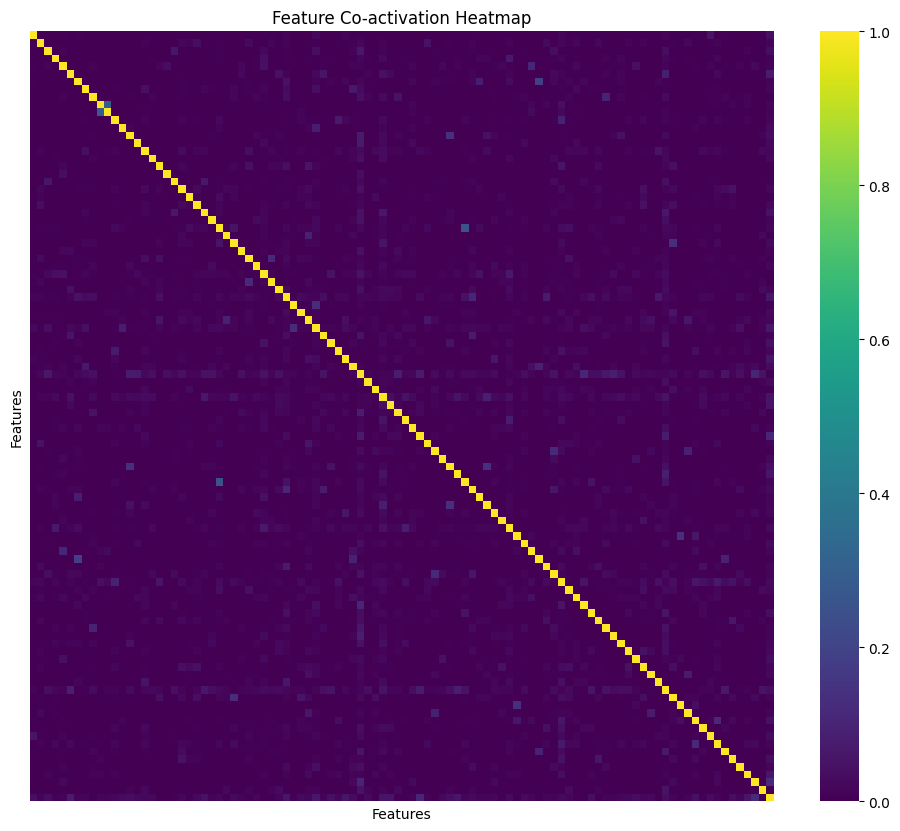

In [64]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def visualize_coactivation_matrix(coactivation_matrix, n_features=100):
    # Select top n_features if the matrix is too large
    if coactivation_matrix.shape[0] > n_features:
        total_activations = coactivation_matrix.sum(axis=1)
        # top_features = total_activations.argsort()[-n_features:]
        top_features = np.arange(n_features)
        coactivation_matrix = coactivation_matrix[top_features][:, top_features]
        diag = np.diag(coactivation_matrix)
        # Create a 2D grid of the diagonal for broadcasting
        normalization_matrix = np.minimum(diag[:, np.newaxis], diag[np.newaxis, :])
        coactivation_matrix = coactivation_matrix / normalization_matrix
            
    plt.figure(figsize=(12, 10))
    sns.heatmap(coactivation_matrix, cmap='viridis', xticklabels=False, yticklabels=False)
    plt.title('Feature Co-activation Heatmap')
    plt.xlabel('Features')
    plt.ylabel('Features')
    plt.show()

# Usage
visualize_coactivation_matrix(cm.cpu())

In [68]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

def visualize_tsne(coactivation_matrix):
    # Perform t-SNE
    tsne = TSNE(n_components=2, random_state=42)
    tsne_result = tsne.fit_transform(coactivation_matrix)
    return tsne_result
    
# Usage
tsne_result = visualize_tsne(cm.cpu().numpy())

In [69]:
tsne_result

array([[ 24.356953, -35.519264],
       [-45.501057, -20.706596],
       [ 12.655469, -15.03025 ],
       ...,
       [ 36.815853,  56.550793],
       [ 50.10772 ,  20.605112],
       [-26.562307, -57.4128  ]], dtype=float32)

In [79]:
cm = cm.cpu().numpy()
r_values = r.cpu().numpy()

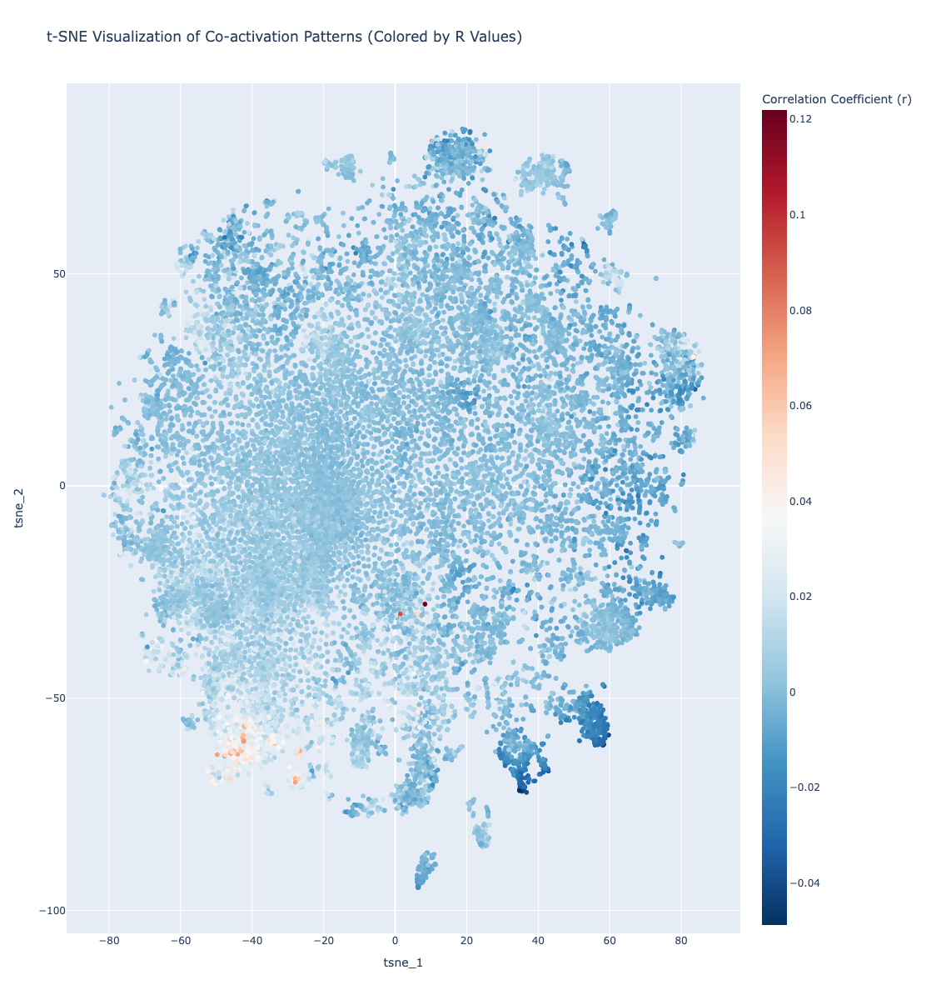

In [84]:
# Calculate total activations for each feature
total_activations = np.sum(cm, axis=1)

df = pd.DataFrame({
    'tsne_1': tsne_result[:, 0],
    'tsne_2': tsne_result[:, 1],
    'r_value': r_values,
    'total_activations': total_activations,
    'feature_index': range(len(cm))
})

# Create the Plotly figure
fig = px.scatter(df, x='tsne_1', y='tsne_2', 
                 color='r_value',
                 hover_data=['feature_index', 'r_value', 'total_activations'],
                 labels={'r_value': 'Correlation Coefficient (r)'},
                 title='t-SNE Visualization of Co-activation Patterns (Colored by R Values)',
                 color_continuous_scale='RdBu_r',
                 width=1200, height=1200)  # Red-Blue diverging color scale

fig.show()

In [57]:
cm_slice = cm[:6, :6].cpu().numpy()
cm_slice
diag = np.diag(cm_slice)
    
# Create a 2D grid of the diagonal for broadcasting
normalization_matrix = np.minimum(diag[:, np.newaxis], diag[np.newaxis, :])
normalized_matrix = cm_slice / normalization_matrix
print((cm_slice * online_coact.n).round())
print()
print(normalization_matrix)
print()
print(normalized_matrix)

[[ 448.    0.    0.    0.    3.    0.]
 [   0.  184.    0.    0.    0.    0.]
 [   0.    0.  348.    0.    3.    0.]
 [   0.    0.    0.  244.    0.    0.]
 [   3.    0.    3.    0. 2216.    0.]
 [   0.    0.    0.    0.    0.   95.]]

[[0.001781  0.0007315 0.001384  0.00097   0.001781  0.0003777]
 [0.0007315 0.0007315 0.0007315 0.0007315 0.0007315 0.0003777]
 [0.001384  0.0007315 0.001384  0.00097   0.001384  0.0003777]
 [0.00097   0.0007315 0.00097   0.00097   0.00097   0.0003777]
 [0.001781  0.0007315 0.001384  0.00097   0.00881   0.0003777]
 [0.0003777 0.0003777 0.0003777 0.0003777 0.0003777 0.0003777]]

[[1.      0.      0.      0.      0.00669 0.     ]
 [0.      1.      0.      0.      0.      0.     ]
 [0.      0.      1.      0.      0.00861 0.     ]
 [0.      0.      0.      1.      0.      0.     ]
 [0.00669 0.      0.00861 0.      1.      0.     ]
 [0.      0.      0.      0.      0.      1.     ]]


In [ ]:
import torch
import numpy as np
from scipy import stats

def calculate_correlations_and_pvalues(X_list, y_list):
    n_features = X_list[0].shape[1]
    n_samples = sum(X.shape[0] for X in X_list)

    # Initialize accumulators
    sum_X = torch.zeros(n_features)
    sum_y = 0.0
    sum_XY = torch.zeros(n_features)
    sum_X_squared = torch.zeros(n_features)
    sum_y_squared = 0.0

    # Compute sums
    for X, y in zip(X_list, y_list):
        sum_X += X.sum(dim=0)
        sum_y += y.sum()
        sum_XY += (X * y.unsqueeze(1)).sum(dim=0)
        sum_X_squared += (X ** 2).sum(dim=0)
        sum_y_squared += (y ** 2).sum()

    # Compute correlations
    numerator = n_samples * sum_XY - sum_X * sum_y
    denominator_X = torch.sqrt(n_samples * sum_X_squared - sum_X ** 2)
    denominator_y = torch.sqrt(n_samples * sum_y_squared - sum_y ** 2)
    correlations = numerator / (denominator_X * denominator_y)

    # Compute t-statistics and p-values
    t_stats = correlations * np.sqrt((n_samples - 2) / (1 - correlations ** 2))
    p_values = 2 * (1 - stats.t.cdf(torch.abs(t_stats), n_samples - 2))

    return correlations, p_values

correlations, p_values = calculate_correlations_and_pvalues(feats_list, kl_list)

print("Correlations shape:", correlations.shape)
print("P-values shape:", p_values.shape)

# Print a few example correlations and their p-values
for i in range(5):
    print(f"Feature {i}: Correlation = {correlations[i]:.4f}, p-value = {p_values[i]:.4f}")

In [ ]:
import statsmodels.api as sm

# Concatenate all tensors
X = torch.cat(feats_list, dim=0)
y = torch.cat(kl_list, dim=0)

# Convert to numpy for statsmodels
X = X.numpy()
y = y.numpy()

# Add a constant term to the features for the intercept
X = sm.add_constant(X)

# Fit the model
model = sm.OLS(y, X)
results = model.fit()

# Print the summary
print(results.summary())

# Access specific statistics
print("Coefficients:")
print(results.params)

print("\nP-values:")
print(results.pvalues)

print("\nR-squared:")
print(results.rsquared)

# If you want to analyze correlation coefficients
correlation_matrix = np.corrcoef(X.T, y)
print("\nCorrelation with target:")
print(correlation_matrix[-1, :-1])  # Correlation of each feature with the target

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [ ]:
import torch
import numpy as np
from sklearn.linear_model import LinearRegression
from scipy import stats

def process_batches(X_list, y_list, batch_size=32):
    model = LinearRegression()
    X_mean = torch.zeros(X_list[0].shape[1])
    y_mean = 0
    n_samples = 0

    # First pass: Compute means
    for X_batch, y_batch in zip(X_list, y_list):
        X_mean += X_batch.sum(dim=0)
        y_mean += y_batch.sum()
        n_samples += X_batch.shape[0]
    
    X_mean /= n_samples
    y_mean /= n_samples

    # Second pass: Compute covariance matrices
    cov_matrix = torch.zeros((X_list[0].shape[1], X_list[0].shape[1]))
    cov_vector = torch.zeros(X_list[0].shape[1])

    for X_batch, y_batch in zip(X_list, y_list):
        X_centered = X_batch - X_mean
        y_centered = y_batch - y_mean
        cov_matrix += X_centered.T @ X_centered
        cov_vector += X_centered.T @ y_centered

    cov_matrix /= n_samples
    cov_vector /= n_samples

    # Compute coefficients
    coefficients = torch.linalg.solve(cov_matrix, cov_vector)
    intercept = y_mean - (X_mean @ coefficients)

    # Compute residuals and R-squared
    y_pred = torch.cat([X_batch @ coefficients + intercept for X_batch in X_list])
    y_true = torch.cat(y_list)
    residuals = y_true - y_pred
    ss_res = (residuals ** 2).sum()
    ss_tot = ((y_true - y_true.mean()) ** 2).sum()
    r_squared = 1 - (ss_res / ss_tot)

    # Compute standard errors and p-values
    mse = ss_res / (n_samples - X_list[0].shape[1] - 1)
    se = torch.sqrt(mse * torch.diagonal(torch.linalg.inv(cov_matrix)))
    t_values = coefficients / se
    p_values = 2 * (1 - stats.t.cdf(torch.abs(t_values), n_samples - X_list[0].shape[1] - 1))

    return coefficients, intercept, r_squared, p_values

coefficients, intercept, r_squared, p_values = process_batches(feats_list, kl_list)

print("Coefficients shape:", coefficients.shape)
print("Intercept:", intercept)
print("R-squared:", r_squared)
print("P-values shape:", p_values.shape)

# Print a few example coefficients and their p-values
for i in range(5):
    print(f"Feature {i}: Coefficient = {coefficients[i]:.4f}, p-value = {p_values[i]:.4f}")

In [ ]:
model.tokenizer

GPTNeoXTokenizerFast(name_or_path='EleutherAI/pythia-70m-deduped', vocab_size=50254, model_max_length=1000000000000000019884624838656, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<|endoftext|>', 'eos_token': '<|endoftext|>', 'unk_token': '<|endoftext|>', 'pad_token': '<|endoftext|>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<|endoftext|>", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	1: AddedToken("<|padding|>", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	50254: AddedToken("                        ", rstrip=False, lstrip=False, single_word=False, normalized=True, special=False),
	50255: AddedToken("                       ", rstrip=False, lstrip=False, single_word=False, normalized=True, special=False),
	50256: AddedToken("                      ", rstrip=False, lstrip=False, single_word=False, normalized=True, special=False),
	50257:

In [ ]:
model.tokenizer("asdf")

{'input_ids': [0, 284, 4989], 'attention_mask': [1, 1, 1]}